<img src="https://imgur.com/zKoxTmm.jpg" alt="cover photo" style="max-width:100%;">



# I. Introduction
The data analysis project compares and analyzes the credit risk profiles of FannieMae SFH (Single Family Home) mortgage loans originated in 1Q2008, 1Q2018, and 1Q2022. In 2008, the subprime mortgage market triggered a financial meltdown due to several years of increasing SFH prices, combined with low interest rates and subpar lending practices. A similar trend was observed in 2018, just before the pandemic, with rapidly rising SFH prices and low interest rates. However, in 2022, we observed the onset of rising interest rates and SFH prices concurrently.  Has the lending practice improved in the post-2008 Financial Crisis?  In light of our observations for 2008 & 2018, what can we tell about the 2022?  Moreover, did the lenders accurately predicted the risk profiles of their borrowers and priced them accurately?

We will compare and contrast the borrower risk profiles for SFH mortgage loans originated in the first quarters of 2008, 2018, and 2022. The analysis will focus on key risk indicators, including FICO score, Debt-to-Income ratio, and Loan-to-Value ratio. By examining these risk indicators at loan origination, we aim to define the risk profile for each vintage.  Furthermore, we will analyze the loan performance in terms of derogatory behaviors such as non-payments and loan charge-offs. This analysis will allow us to compare the actual loan performance against the borrower risk profile at the time of loan origination.

#### **Problem Statement #1:**
 How has the risk profile changed before & after the 2008 Subprime Mortgage Crisis?  And what is the outlook for the more recent vintage loans in 1Q2022? 

#### **Problem Statement #2:**
Risk and return are two sides of the same coin!  Has the interest rate (i.e. return) accurately reflected the risk associated with different risk profiles?


We begin by importing the necessary Python:

In [1]:
!pip install seaborn --quiet
!pip install matplotlib --quiet
!pip install plotly --quiet

In [2]:
import pandas as pd
import numpy as np
from pandas import DataFrame

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# II. Data Extract, Transform, and Load (ETL)
FannieMae data on Single Family Home (SFH) mortgage data can be found at 
https://apps.pingone.com/4c2b23f9-52b1-4f8f-aa1f-1d477590770c/signon/?flowId=032ba0ab-3640-4fc2-aefd-4cc49ab2b9c1

One can automate the data download using request library but it is much simpler to log-in and download the data:

<img src= "https://i.imgur.com/9okaA5w.jpg">

In [ ]:
# the downloaded mortgage data are saved on the C: drive, and below is the file folder path.
path=r'/Users/donovankim/Library/CloudStorage/GoogleDrive-kimdukho@gmail.com/My Drive/US Mortgage Market Analysis/'

In [ ]:
# the meta data for these columns are found at https://capitalmarkets.fanniemae.com/media/6931/display

columns=["POOL_ID", "LOAN_ID", "ACT_PERIOD", "CHANNEL", "SELLER", "SERVICER",
                        "MASTER_SERVICER", "ORIG_RATE", "CURR_RATE", "ORIG_UPB", "ISSUANCE_UPB",
                        "CURRENT_UPB", "ORIG_TERM", "ORIG_DATE", "FIRST_PAY", "LOAN_AGE",
                        "REM_MONTHS", "ADJ_REM_MONTHS", "MATR_DT", "OLTV", "OCLTV",
                        "NUM_BO", "DTI", "CSCORE_B", "CSCORE_C", "FIRST_FLAG", "PURPOSE",
                        "PROP", "NO_UNITS", "OCC_STAT", "STATE", "MSA", "ZIP", "MI_PCT",
                        "PRODUCT", "PPMT_FLG", "IO", "FIRST_PAY_IO", "MNTHS_TO_AMTZ_IO",
                        "DLQ_STATUS", "PMT_HISTORY", "MOD_FLAG", "MI_CANCEL_FLAG", "Zero_Bal_Code",
                        "ZB_DTE", "LAST_UPB", "RPRCH_DTE", "CURR_SCHD_PRNCPL", "TOT_SCHD_PRNCPL",
                        "UNSCHD_PRNCPL_CURR", "LAST_PAID_INSTALLMENT_DATE", "FORECLOSURE_DATE",
                        "DISPOSITION_DATE", "FORECLOSURE_COSTS", "PROPERTY_PRESERVATION_AND_REPAIR_COSTS",
                        "ASSET_RECOVERY_COSTS", "MISCELLANEOUS_HOLDING_EXPENSES_AND_CREDITS",
                        "ASSOCIATED_TAXES_FOR_HOLDING_PROPERTY", "NET_SALES_PROCEEDS",
                        "CREDIT_ENHANCEMENT_PROCEEDS", "REPURCHASES_MAKE_WHOLE_PROCEEDS",
                        "OTHER_FORECLOSURE_PROCEEDS", "NON_INTEREST_BEARING_UPB", "PRINCIPAL_FORGIVENESS_AMOUNT",
                        "ORIGINAL_LIST_START_DATE", "ORIGINAL_LIST_PRICE", "CURRENT_LIST_START_DATE",
                        "CURRENT_LIST_PRICE", "ISSUE_SCOREB", "ISSUE_SCOREC", "CURR_SCOREB",
                        "CURR_SCOREC", "MI_TYPE", "SERV_IND", "CURRENT_PERIOD_MODIFICATION_LOSS_AMOUNT",
                        "CUMULATIVE_MODIFICATION_LOSS_AMOUNT", "CURRENT_PERIOD_CREDIT_EVENT_NET_GAIN_OR_LOSS",
                        "CUMULATIVE_CREDIT_EVENT_NET_GAIN_OR_LOSS", "HOMEREADY_PROGRAM_INDICATOR",
                        "FORECLOSURE_PRINCIPAL_WRITE_OFF_AMOUNT", "RELOCATION_MORTGAGE_INDICATOR",
                        "ZERO_BALANCE_CODE_CHANGE_DATE", "LOAN_HOLDBACK_INDICATOR", "LOAN_HOLDBACK_EFFECTIVE_DATE",
                        "DELINQUENT_ACCRUED_INTEREST", "PROPERTY_INSPECTION_WAIVER_INDICATOR",
                        "HIGH_BALANCE_LOAN_INDICATOR", "ARM_5_YR_INDICATOR", "ARM_PRODUCT_TYPE",
                        "MONTHS_UNTIL_FIRST_PAYMENT_RESET", "MONTHS_BETWEEN_SUBSEQUENT_PAYMENT_RESET",
                        "INTEREST_RATE_CHANGE_DATE", "PAYMENT_CHANGE_DATE", "ARM_INDEX",
                        "ARM_CAP_STRUCTURE", "INITIAL_INTEREST_RATE_CAP", "PERIODIC_INTEREST_RATE_CAP",
                        "LIFETIME_INTEREST_RATE_CAP", "MARGIN", "BALLOON_INDICATOR",
                        "PLAN_NUMBER", "FORBEARANCE_INDICATOR", "HIGH_LOAN_TO_VALUE_HLTV_REFINANCE_OPTION_INDICATOR",
                        "DEAL_NAME", "RE_PROCS_FLAG", "ADR_TYPE", "ADR_COUNT", "ADR_UPB"]



In [ ]:
# Because the original data in csv file is very big (approximate 5.2GB), the files will be read in chunks.
# Below is the function to extract the data by state 

chunk_size=10000

def getfile(year_quarter, state):
    my_list = []
    for chunk in pd.read_csv(path+'/20'+str(year_quarter)+'.csv', sep="|", names=columns, low_memory=False,
                             header=None, chunksize=chunk_size):
        chunk = chunk.loc[chunk['STATE'] == state]
        my_list.append(chunk)
    file = pd.concat(my_list, axis=0)
    
    file.to_csv(path+'state_file_20'+str(year_quarter)+'.csv', index=False)
    return file

file_2022q1_CA = getfile('22Q1','CA')

In [ ]:
# due to large file size, we will sample only 10% of the population  

chunk_size=10000

def get_subset(year_quarter):
    my_list = []
    for chunk in pd.read_csv(path+'/20'+str(year_quarter)+'.csv', sep="|", names=columns, low_memory=False,
                             header=None, chunksize=chunk_size):
        chunk_sub = chunk[chunk['LOAN_ID'] % 10 == 1]
        my_list.append(chunk_sub)
    file = pd.concat(my_list, axis=0)
    
    file.to_csv(path+'file_20'+str(year_quarter)+'.csv', index=False)
    return file

file_df08q1 = get_subset('08Q1')
file_df18q1 = get_subset('18Q1')
file_df22q1 = get_subset('22Q1')


In [195]:
file_df08q1 = pd.read_csv('/Users/donovankim/Library/CloudStorage/GoogleDrive-kimdukho@gmail.com/My Drive/US Mortgage Market Analysis/us_mort_file_2008Q1.csv')
file_df18q1 = pd.read_csv('/Users/donovankim/Library/CloudStorage/GoogleDrive-kimdukho@gmail.com/My Drive/US Mortgage Market Analysis/us_mort_file_2018Q1.csv')
file_df22q1 = pd.read_csv('/Users/donovankim/Library/CloudStorage/GoogleDrive-kimdukho@gmail.com/My Drive/US Mortgage Market Analysis/us_mort_file_2022Q1.csv')

<ipython-input-195-96875b756fcc>:1: DtypeWarning:

Columns (40,101,105) have mixed types. Specify dtype option on import or set low_memory=False.

<ipython-input-195-96875b756fcc>:3: DtypeWarning:

Columns (105) have mixed types. Specify dtype option on import or set low_memory=False.



In [196]:
print("The shape of 1Q2008 dataset that is only 10% sample is ",file_df08q1.shape)
print("The shape of 1Q2018 dataset that is only 10% sample is ",file_df18q1.shape)
print("The shape of 1Q2022 dataset that is only 10% sample is ",file_df22q1.shape)

The shape of 1Q2008 dataset that is only 10% sample is  (2193034, 108)
The shape of 1Q2018 dataset that is only 10% sample is  (1861960, 108)
The shape of 1Q2022 dataset that is only 10% sample is  (866615, 108)


### Loan Origination Data 
For the analysis of borrower profile at the time of loan origination, only the first month of data will be examined. 

In [197]:
orig_file_08q1=file_df08q1.drop_duplicates(subset=['POOL_ID', 'LOAN_ID'], keep='first')
orig_file_18q1=file_df18q1.drop_duplicates(subset=['POOL_ID', 'LOAN_ID'], keep='first')
orig_file_22q1=file_df22q1.drop_duplicates(subset=['POOL_ID', 'LOAN_ID'], keep='first')

In [277]:
print("Number of loans at the origination in 2008Q1: {}".format(orig_file_08q1.LOAN_ID.count()))
print("Number of loans at the origination in 2018Q1: {}".format(orig_file_18q1.LOAN_ID.count()))
print("Number of loans at the origination in 2022Q1: {}".format(orig_file_22q1.LOAN_ID.count()))


Number of loans at the origination in 2008Q1: 38128
Number of loans at the origination in 2018Q1: 46109
Number of loans at the origination in 2022Q1: 79353


### Null Imputation on Origination Loan Data
Only following four important features will be imputed for null values:
* 'CSCORE_B' & 'CSCORE_C' are respectively FICO scores of Primary and Co-Borrower.  When evaluating a joint-borrower loan application, most financial institutions will only consider the lower of the two FICO scores (i.e. 'CSCORE_B' & 'CSCORE_C') to adjudicate the loan.  Therefore, only when FICO scores of both applicants are missing the row will be dropped.
* Only small number of 'DTI' (Debt-to-Income) ratios has null values.  These will be replaced with the mean value.
* 'OLTV' (Original Loan-to-Value) has no null values. 

In [205]:
print("Null values in 1Q2008 \n",orig_file_08q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())
print("Null values in 1Q2018 \n",orig_file_18q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())
print("Null values in 1Q2022 \n",orig_file_22q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())

Null values in 1Q2008 
 CSCORE_B       35
CSCORE_C    21405
DTI          1137
OLTV            0
dtype: int64
Null values in 1Q2018 
 CSCORE_B       11
CSCORE_C    25732
DTI            14
OLTV            0
dtype: int64
Null values in 1Q2022 
 CSCORE_B       44
CSCORE_C    44889
DTI            10
OLTV            0
dtype: int64


In [208]:
orig_file_08q1.drop(orig_file_08q1.loc[(pd.isna(orig_file_08q1['CSCORE_B'])) & 
                                       (pd.isna(orig_file_08q1['CSCORE_C']))].index, inplace=True) 
orig_file_18q1.drop(orig_file_18q1.loc[(pd.isna(orig_file_18q1['CSCORE_B'])) & 
                                       (pd.isna(orig_file_18q1['CSCORE_C']))].index, inplace=True) 
orig_file_22q1.drop(orig_file_22q1.loc[(pd.isna(orig_file_22q1['CSCORE_B'])) & 
                                       (pd.isna(orig_file_22q1['CSCORE_C']))].index, inplace=True) 

orig_file_08q1.DTI.fillna('mean', inplace=True)
orig_file_18q1.DTI.fillna('mean', inplace=True)
orig_file_22q1.DTI.fillna('mean', inplace=True)

<ipython-input-208-7a8c168e959a>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-208-7a8c168e959a>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-208-7a8c168e959a>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-208-7a8c168e959a>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/

In [209]:
print("Null values in 1Q2008 \n",orig_file_08q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())
print("Null values in 1Q2018 \n",orig_file_18q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())
print("Null values in 1Q2022 \n",orig_file_22q1[['CSCORE_B', 'CSCORE_C', 'DTI', 'OLTV']].isna().sum())

Null values in 1Q2008 
 CSCORE_B       14
CSCORE_C    21384
DTI             0
OLTV            0
dtype: int64
Null values in 1Q2018 
 CSCORE_B       11
CSCORE_C    25732
DTI             0
OLTV            0
dtype: int64
Null values in 1Q2022 
 CSCORE_B       15
CSCORE_C    44860
DTI             0
OLTV            0
dtype: int64


# III. Data Analysis

The subprime mortgage and the resulting financial crisis that started in 3Q2008 is attributed to the sub-standard underwriting (approval of loan applications) of many mortgage loans.  Prior to the tightening of the underwriting rule by the Feds in 3Q2008, large proportions of loans were considered subprime, i.e. commonly measured by low FICO scores.  Let us compare some key metrics in 1Q2008, 1Q2018 & 1Q2022 to see how the loan quality compares. 

## Analysis 1: Loan Quality - FICO Score
* FICO score is the simplest and most common measure of loan quality.  The higher the score, the lower the risk.
* In cases when there are two borrowers such as husband & wife, "CSCORE_B" in the FICO score of primary borrower and "CSCORE_C" is the score of the co-borrower.  When there is only one borrower, the "CSCORE_C" will be missing. 
 

A new dataframe that only contains the FICO scores of the primary, the co-borrower and the minimum of the two scores are created.  Mortgage companies when evaluating the loan appplication, the lower of the two FICO scores from the borrowers is used to evlauate the loan application.

In [210]:
fico_08q1 = orig_file_08q1[["CSCORE_B","CSCORE_C"]].copy()
fico_18q1 = orig_file_18q1[["CSCORE_B","CSCORE_C"]].copy()
fico_22q1 = orig_file_22q1[["CSCORE_B","CSCORE_C"]].copy()

fico_08q1.rename({"CSCORE_B": "Primary_08","CSCORE_C":"Co-Borrower_08"}, axis=1, inplace=True) 
fico_18q1.rename({"CSCORE_B": "Primary_18","CSCORE_C":"Co-Borrower_18"}, axis=1, inplace=True) 
fico_22q1.rename({"CSCORE_B": "Primary_22","CSCORE_C":"Co-Borrower_22"}, axis=1, inplace=True) 

fico_08q1['min_fico_08'] = fico_08q1[["Primary_08","Co-Borrower_08"]].min(axis=1) 
fico_18q1['min_fico_18'] = fico_18q1[["Primary_18","Co-Borrower_18"]].min(axis=1) 
fico_22q1['min_fico_22'] = fico_22q1[["Primary_22","Co-Borrower_22"]].min(axis=1) 


fico_combined = pd.concat([fico_08q1, fico_18q1, fico_22q1], axis=1)
fico_combined.sample(10)

,Primary_08,Co-Borrower_08,min_fico_08,Primary_18,Co-Borrower_18,min_fico_18,Primary_22,Co-Borrower_22,min_fico_22
252464,NaN,NaN,NaN,NaN,NaN,NaN,804.0,792.0,792.0
272527,NaN,NaN,NaN,NaN,NaN,NaN,719.0,NaN,719.0
721734,NaN,NaN,NaN,NaN,NaN,NaN,683.0,NaN,683.0
491328,NaN,NaN,NaN,NaN,NaN,NaN,637.0,NaN,637.0
580211,NaN,NaN,NaN,780.0,NaN,780.0,NaN,NaN,NaN
1417735,598.0,NaN,598.0,NaN,NaN,NaN,NaN,NaN,NaN
633035,NaN,NaN,NaN,803.0,765.0,765.0,NaN,NaN,NaN
833523,NaN,NaN,NaN,NaN,NaN,NaN,725.0,721.0,721.0
751824,NaN,NaN,NaN,NaN,NaN,NaN,796.0,806.0,796.0
697002,NaN,NaN,NaN,NaN,NaN,NaN,658.0,NaN,658.0


In [211]:
fico_combined[["min_fico_08", "min_fico_18", "min_fico_22"]].describe()

,min_fico_08,min_fico_18,min_fico_22
count,38128.000000,46109.000000,79353.000000
mean,725.193585,741.653907,746.952377
std,57.350606,47.806776,47.125321
min,459.000000,620.000000,513.000000
25%,685.000000,707.000000,714.000000
50%,732.000000,748.000000,756.000000
75%,774.000000,782.000000,786.000000
max,850.000000,829.000000,831.000000


In [296]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

name_mapping = {'min_fico_08': 'FICO_08', 'min_fico_18': 'FICO_18', 'min_fico_22': 'FICO_22'}


vars = ["min_fico_08", "min_fico_18", "min_fico_22"]
fig = make_subplots(rows=1, cols=len(vars), shared_yaxes=True)

for i, var in enumerate(vars):
    new_name = name_mapping.get(var, var)
    fig.add_trace(
        go.Box(y=fico_combined[var], name=new_name),
        row=1, col=i+1
    )

fig.update_traces(boxpoints='all', jitter=.3)
fig.update_layout(title="Distribution of Min_FICO Scores by Vintage", legend=dict(orientation='h', x=0.5, y=1.2))
fig.show()


#### **Insight** - Borrowers' FICO Score Distribution  
Note that no loans with a FICO score under 620 were approved in 1Q2018. Average FICO scores improved in 2018 and 2022 compared to 2008, with scores of 742 in 1Q2018 and 747 in 1Q2022, compared to 725 in 1Q2008. Additionally, the distribution of borrowers' FICO scores is more condensed in 2018 and 2022, indicating that lenders have tightened their loan approval criteria.

In [213]:
orig_file_08q1['min_fico'] = orig_file_08q1.loc[:,["CSCORE_B","CSCORE_C"]].min(axis=1)
orig_file_18q1['min_fico'] = orig_file_18q1.loc[:,["CSCORE_B","CSCORE_C"]].min(axis=1)
orig_file_22q1['min_fico'] = orig_file_22q1.loc[:,["CSCORE_B","CSCORE_C"]].min(axis=1)


<ipython-input-213-c04c80f17f45>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-213-c04c80f17f45>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-213-c04c80f17f45>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [215]:
def fico_band(x):
    if pd.isna(x):
        return "581~620"
    elif x < 580:
        return "below 580"
    elif x <= 620:
        return "581~620"
    elif x <= 660:
        return "621-660"
    elif x <= 700:
        return "661-700"        
    elif x <= 740:
        return "701-740"
    elif x <= 780:
        return "741-780"
    elif x <= 820:
        return "781-820"
    else:
        return "820+"

orig_file_08q1['fico_band'] = orig_file_08q1['min_fico'].apply(fico_band)
orig_file_18q1['fico_band'] = orig_file_18q1['min_fico'].apply(fico_band)
orig_file_22q1['fico_band'] = orig_file_22q1['min_fico'].apply(fico_band)


<ipython-input-215-859c579d46e2>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-215-859c579d46e2>:22: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-215-859c579d46e2>:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [216]:
fico_band_08_df = orig_file_08q1.groupby('fico_band')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_08'}, axis=1)
fico_band_18_df = orig_file_18q1.groupby('fico_band')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_18'}, axis=1)
fico_band_22_df = orig_file_22q1.groupby('fico_band')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_22'}, axis=1)

fico_band_df = pd.merge(fico_band_08_df, fico_band_18_df, on='fico_band', how="left")
fico_band_df = pd.merge(fico_band_df, fico_band_22_df, on='fico_band', how="left")

fico_band_df.fillna(0, inplace=True)

fico_band_df

,fico_band,loan_count_08,loan_count_18,loan_count_22
0,581~620,1506,51.0,201
1,621-660,3956,3031.0,4117
2,661-700,6950,6803.0,10485
3,701-740,8072,10797.0,16374
4,741-780,9745,13365.0,24569
5,781-820,7618,11991.0,23356
6,820+,29,71.0,239
7,below 580,252,0.0,12


In [217]:
fico_band_df['loan_perc_dist_08'] = fico_band_df['loan_count_08']/fico_band_df['loan_count_08'].sum()
fico_band_df['loan_perc_dist_18'] = fico_band_df['loan_count_18']/fico_band_df['loan_count_18'].sum()
fico_band_df['loan_perc_dist_22'] = fico_band_df['loan_count_22']/fico_band_df['loan_count_22'].sum()

fico_band_df


,fico_band,loan_count_08,loan_count_18,loan_count_22,loan_perc_dist_08,loan_perc_dist_18,loan_perc_dist_22
0,581~620,1506,51.0,201,0.039499,0.001106,0.002533
1,621-660,3956,3031.0,4117,0.103756,0.065736,0.051882
2,661-700,6950,6803.0,10485,0.182281,0.147542,0.132131
3,701-740,8072,10797.0,16374,0.211708,0.234163,0.206344
4,741-780,9745,13365.0,24569,0.255586,0.289857,0.309617
5,781-820,7618,11991.0,23356,0.199801,0.260058,0.294330
6,820+,29,71.0,239,0.000761,0.001540,0.003012
7,below 580,252,0.0,12,0.006609,0.000000,0.000151


In [295]:
fig = go.Figure()

fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_count_08"], name="1Q2008 Vintage",
              text=fico_band_df["loan_count_08"], textposition='auto', texttemplate='%{text:,}'))
fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_count_18"], name="1Q2018 Vintage",
              text=fico_band_df["loan_count_18"], textposition='auto', texttemplate='%{text:,}'))
fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_count_22"], name="2Q2022 Vintage",
              text=fico_band_df["loan_count_22"], textposition='auto', texttemplate='%{text:,}'))

fig.update_layout(title="Number of Loans by FICO Band for Each Vintage", 
                  yaxis={'title':'Number of Borrowers'},
                  xaxis={'title': 'FICO Band',
                         'categoryorder': 'array',
                         'categoryarray': ['below 580', '581~620', '621-660', '661-700', '701-740', '741-780', '781-820', '820+']},
                  legend=dict(orientation='h', x=0.5, y=1.2))

fig.show()

In [275]:
fig = go.Figure()

fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_perc_dist_08"], name="1Q2008 Vintage",
              text=fico_band_df["loan_perc_dist_08"], textposition='auto', texttemplate='%{text:.1%}'))
fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_perc_dist_18"], name="1Q2018 Vintage",
              text=fico_band_df["loan_perc_dist_18"], textposition='auto', texttemplate='%{text:.1%}'))
fig.add_trace(go.Bar(x=fico_band_df["fico_band"], y=fico_band_df["loan_perc_dist_22"], name="2Q2022 Vintage",
              text=fico_band_df["loan_perc_dist_22"], textposition='auto', texttemplate='%{text:.1%}'))

fig.update_layout(title="Percentage Distribution of Loans by FICO Band", yaxis=dict(tickformat=".2%"),
                  xaxis={'title': 'FICO Band',
                         'categoryorder': 'array',
                         'categoryarray': ['below 580', '581~620', '621-660', '661-700', '701-740', '741-780', '781-820', '820+']},
                  legend=dict(orientation='h',  # Horizontal legend orientation 
                              x=0.5,  # X position of the legend inside the chart 
                              y=1.2  # Y position of the legend inside the chart 
                              ))

fig.show()


#### **Insight** - Loan Distribution by FICO Band 
In 1Q2008, 66.8% of all borrowers had a FICO score higher than 700. However, in 2Q2018 and 1Q2022, these figures improved significantly, reaching 78.6% and 81.3% respectively. This confirms a substantial improvement in credit risk profiles since the financial crisis of 2008.

## Analysis 2: Loan Purpose
Borrowers take out loans for two primary purposes: to purchase a new home or to refinance an existing mortgage. In the case of refinancing, borrowers have the option to cash out on the increased value of their home relative to the mortgage amount. This means that when the value of the home increases, borrowers can increase the loan amount and receive the extra funds as cash. For example, if a borrower has an existing mortgage of $700K with a 6% interest rate, they may choose to refinance with another bank offering a lower interest rate of 4.5%. This would be a simple refinancing. However, the borrower may also decide to increase the loan amount to $800K and use the additional $100K for home remodeling. This type of refinancing is known as "cash-out" refinancing.


During the real estate speculation frenzy prior to the 2008 financial crisis, many borrowers turned to "cash-out" refinancing as a means to finance new home purchases or fund general consumption. However, this type of refinancing, which involves extracting cash from the increased equity of the property, only exacerbated speculative behavior and was generally viewed unfavorably.

In [45]:
loan_purpose_08q1 = orig_file_08q1.groupby('PURPOSE')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_08'}, axis=1)
loan_purpose_18q1 = orig_file_18q1.groupby('PURPOSE')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_18'}, axis=1)
loan_purpose_22q1 = orig_file_22q1.groupby('PURPOSE')['LOAN_ID'].count().reset_index().rename({'LOAN_ID':'loan_count_22'}, axis=1)

loan_purpose_df = pd.merge(loan_purpose_08q1, loan_purpose_18q1, on='PURPOSE', how="left")
loan_purpose_df = pd.merge(loan_purpose_df, loan_purpose_22q1, on='PURPOSE', how="left")

loan_purpose_df


,PURPOSE,loan_count_08,loan_count_18,loan_count_22
0,C,15854,12712,28146
1,P,10007,24772,30826
2,R,12288,8646,20410


In [46]:
loan_purpose_df['loan_purp_perc_08'] = loan_purpose_df['loan_count_08']/loan_purpose_df['loan_count_08'].sum()
loan_purpose_df['loan_purp_perc_18'] = loan_purpose_df['loan_count_18']/loan_purpose_df['loan_count_18'].sum()
loan_purpose_df['loan_purp_perc_22'] = loan_purpose_df['loan_count_22']/loan_purpose_df['loan_count_22'].sum()

loan_purpose_df

,PURPOSE,loan_count_08,loan_count_18,loan_count_22,loan_purp_perc_08,loan_purp_perc_18,loan_purp_perc_22
0,C,15854,12712,28146,0.415581,0.275569,0.354564
1,P,10007,24772,30826,0.262314,0.537004,0.388325
2,R,12288,8646,20410,0.322105,0.187427,0.257111


In [47]:
loan_purpose_df = loan_purpose_df.rename({'PURPOSE':'purpose'}, axis=1)
loan_purpose_df["purpose"] = loan_purpose_df["purpose"].replace({"C": "Cash-Out", "P": "Purchase", "R": "Refinance"})
loan_purpose_df

,purpose,loan_count_08,loan_count_18,loan_count_22,loan_purp_perc_08,loan_purp_perc_18,loan_purp_perc_22
0,Cash-Out,15854,12712,28146,0.415581,0.275569,0.354564
1,Purchase,10007,24772,30826,0.262314,0.537004,0.388325
2,Refinance,12288,8646,20410,0.322105,0.187427,0.257111


In [294]:
fig = go.Figure()

fig.add_trace(go.Bar(x=loan_purpose_df["purpose"], y=loan_purpose_df["loan_purp_perc_08"], name="1Q2008 Vintage",
              text=loan_purpose_df["loan_purp_perc_08"], textposition='auto', texttemplate='%{text:.1%}'))
fig.add_trace(go.Bar(x=loan_purpose_df["purpose"], y=loan_purpose_df["loan_purp_perc_18"], name="1Q2018 Vintage",
              text=loan_purpose_df["loan_purp_perc_18"], textposition='auto', texttemplate='%{text:.1%}'))
fig.add_trace(go.Bar(x=loan_purpose_df["purpose"], y=loan_purpose_df["loan_purp_perc_22"], name="2Q2022 Vintage",
              text=loan_purpose_df["loan_purp_perc_22"], textposition='auto', texttemplate='%{text:.1%}'))

fig.update_layout(title="Percentage Distribution of Loan Purpose by FICO Band", 
                  yaxis=dict(tickformat=".1%"), 
                  xaxis={'title': 'Loan Purpose'},legend=dict(
        orientation='h',  # Horizontal legend orientation
        x=0.5,  # X position of the legend inside the chart
        y=1.2  # Y position of the legend inside the chart
    ))# Display the bars side by side)


fig.show()

#### **Insight** - Loan Purpose by Loan Vintages
The prevalence of "cash-out" refinancing has decreased significantly in 2018 compared to 2008. However, in 2022, there has been an increase in borrowers choosing to cash out on their improved home equity. The implications of this trend and whether it is a cause for concern are yet to be determined.

## Analysis 3: Interest-Only Mortgage
An interest-only mortgage allows borrowers to make payments solely toward the interest without reducing the principal balance for a specified period, typically 5, 7, or 10 years. At the end of this period, borrowers must refinance the loan or start making regular payments that include both interest and principal. Borrowers often choose interest-only mortgages in anticipation of falling interest rates or rising home values in the future. However, during the speculative investment frenzy in 2008, interest-only mortgages were misused, enabling speculators to purchase homes beyond their means. These speculators hoped to sell the homes at a higher price before principal amortization began, seeking quick profits. However, what happens when home prices don't rise, or worse, fall, or when the home cannot be sold in time?

In [89]:
print("The number of interest-only loans in 1Q2008 was {:,} which is {:.1f}% of all loans originated.".
      format(orig_file_08q1.loc[orig_file_08q1['IO'] != 'N']['LOAN_ID'].count(),
             orig_file_08q1.loc[orig_file_08q1['IO'] != 'N']['LOAN_ID'].count()/orig_file_08q1['LOAN_ID'].count()*100))
print("The number of interest-only loans in 1Q2018 was {:,} which is {:.1f}% of all loans originated.".
      format(orig_file_18q1.loc[orig_file_18q1['IO'] != 'N']['LOAN_ID'].count(),
             orig_file_18q1.loc[orig_file_18q1['IO'] != 'N']['LOAN_ID'].count()/orig_file_18q1['LOAN_ID'].count()*100))
print("The number of interest-only loans in 1Q2022 was {:,} which is {:.1f}% of all loans originated.".
      format(orig_file_22q1.loc[orig_file_22q1['IO'] != 'N']['LOAN_ID'].count(),
             orig_file_22q1.loc[orig_file_22q1['IO'] != 'N']['LOAN_ID'].count()/orig_file_22q1['LOAN_ID'].count()*100))


The number of interest-only loans in 1Q2008 was 8,352 which is 21.9% of all loans originated.
The number of interest-only loans in 1Q2018 was 0 which is 0.0% of all loans originated.
The number of interest-only loans in 1Q2022 was 0 which is 0.0% of all loans originated.


"N" indicates the non-interest-only mortgage.  In 1Q2008, there were 8,352 interest-only loans while no such loans were originated in 1Q2018 & 1Q2022.

In [90]:

io_fico_band_dist = orig_file_08q1.loc[orig_file_08q1['IO'] != 'N']['fico_band'].value_counts(normalize=True).to_frame()
io_fico_band_dist

,fico_band
741-780,0.299808
781-820,0.267960
701-740,0.196719
661-700,0.139488
621-660,0.067768
581~620,0.023587
below 580,0.003592
820+,0.001078


In [118]:
fig = px.bar(io_fico_band_dist, x=io_fico_band_dist.index, y='fico_band', text=io_fico_band_dist['fico_band'])
fig.update_layout(title="Percentage Distribution of Interest-Only Loans by FICO Band - 1Q2008", showlegend=False,
                  yaxis={'title':'Number of Interest-Only Borrowers', 'tickformat': '.0%', 'range':[0, 0.4]}, 
                  xaxis={'title': 'FICO Band',
                         'categoryorder': 'array',
                         'categoryarray': ['below 580', '581~620', '621-660', '661-700', '701-740', '741-780', '781-820', '820+']})

fig.update_traces(texttemplate='%{text:.1%}',  textposition='outside', textfont=dict(size=14))

fig.show()

#### **Insight** - Interest-Only Loan Distribution by FICO Band 
Of the 22% of all mortgages loans originated or 8,352 loans in 1Q2008 were interest-only loans, almost 23.4% were below FICO score below 700 which is considered below average credit rating.  After the financial meltdown, most of these loans were in troubled waters. 

## Analysis 4: Original Loan-To-Value (LTV) Ratio 
Original LTV (OLTV) ratio is determined by how much downpayment borrower makes on the loan. For example, if a home is purchased at $800K and the borrower puts down $200K as the downpayment then the LTV ratio is 75% [($800K - $200K)/$800K]. LTV ratio at origination is a good indicator of loan quality - the lower the LTV the lower the loan risk! However, during the financial meltdown, borrowers often could not make the payment and the unpaid portion accrued to the loan principal, resulting in increasing LTV ratio over time.


In [220]:
oltv_08q1 = orig_file_08q1[['OLTV', 'LOAN_ID']]
oltv_18q1 = orig_file_18q1[['OLTV', 'LOAN_ID']]
oltv_22q1 = orig_file_22q1[['OLTV', 'LOAN_ID']]

oltv_08q1.rename({"OLTV":"oltv_08", 'LOAN_ID':'loan_id_08'}, axis=1, inplace=True)
oltv_18q1.rename({"OLTV":"oltv_18", 'LOAN_ID':'loan_id_18'}, axis=1, inplace=True)
oltv_22q1.rename({"OLTV":"oltv_22", 'LOAN_ID':'loan_id_22'}, axis=1, inplace=True)


oltv_combined = pd.concat([oltv_08q1, oltv_18q1, oltv_22q1], axis=1)
oltv_combined.head()

<ipython-input-220-c2b9aa313253>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-220-c2b9aa313253>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-220-c2b9aa313253>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,oltv_08,loan_id_08,oltv_18,loan_id_18,oltv_22,loan_id_22
0,47.0,1.000018e+11,39.0,1.000202e+11,80.0,130357811.0
66,80.0,1.000218e+11,NaN,NaN,NaN,NaN
107,55.0,1.000884e+11,NaN,NaN,NaN,NaN
141,77.0,1.001275e+11,NaN,NaN,NaN,NaN
200,95.0,1.001409e+11,NaN,NaN,NaN,NaN


In [293]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

name_mapping = {'oltv_08': '1Q2008', 'oltv_18': '1Q2018', 'oltv_22': '1Q2022'}


vars = ["oltv_08", "oltv_18", "oltv_22"]
fig = make_subplots(rows=1, cols=len(vars), shared_yaxes=True)

for i, var in enumerate(vars):
    new_name = name_mapping.get(var, var)
    fig.add_trace(
        go.Box(y=oltv_combined[var], name=new_name),
        row=1, col=i+1
    )

fig.update_traces(boxpoints='all', jitter=.3)
fig.update_layout(title="Original LTV Ratio Distribution by Vintage", legend=dict(
        orientation='h',  # Horizontal legend orientation
        x=0.5,  # X position of the legend inside the chart
        y=1.2  # Y position of the legend inside the chart
    ))# Display the bars side by side)
fig.show()

In [55]:
oltv_combined[["oltv_08", "oltv_18", "oltv_22"]].describe()

,oltv_08,oltv_18,oltv_22
count,38149.000000,46130.000000,79382.000000
mean,70.959108,74.893627,68.647023
std,16.742820,17.256613,19.079614
min,1.000000,5.000000,5.000000
25%,62.000000,66.000000,56.000000
50%,76.000000,80.000000,72.000000
75%,80.000000,90.000000,80.000000
max,97.000000,97.000000,97.000000


#### **Insight** - Loan-to-Value (LTV) Distribution by Loan Vintages
Although the original LTV (Loan-to-Value) ratio in 1Q2022 is lower compared to 1Q2008 and 1Q2018, it is counterintuitive that the ratio in 1Q2018 is higher than 1Q2008. One would expect the ratio to be lower in 1Q2018 due to tighter loan adjudication standards. This suggests that other risk indicators, such as FICO score, may have a stronger influence in the loan adjudication process, potentially overriding the significance of the LTV ratio.

## Analysis 5: Debt-to-income (DTI) Ratio
The Debt-to-Income (DTI) ratio is a measure of a borrower's ability to manage their debt. It is calculated by dividing the total monthly payment obligations, including credit cards, auto loans, student loans, child support, other mortgages, and loans, by the borrower's total monthly income. The maximum DTI ratio set by the industry standard is currently 0.43. The null hypothesis suggests that prior to the subprime financial crisis, when loan standards were less strict, the DTI ratio was higher compared to the post-crisis period.


In [222]:
dti_08q1 = orig_file_08q1[['DTI', 'LOAN_ID']]
dti_18q1 = orig_file_18q1[['DTI', 'LOAN_ID']]
dti_22q1 = orig_file_22q1[['DTI', 'LOAN_ID']]

dti_08q1.rename({"DTI":"dti_08", 'LOAN_ID':'loan_id_08'}, axis=1, inplace=True)
dti_18q1.rename({"DTI":"dti_18", 'LOAN_ID':'loan_id_18'}, axis=1, inplace=True)
dti_22q1.rename({"DTI":"dti_22", 'LOAN_ID':'loan_id_22'}, axis=1, inplace=True)


dti_combined = pd.concat([dti_08q1, dti_18q1, dti_22q1], axis=1)
dti_combined.head()

<ipython-input-222-cf9efb4bc345>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-222-cf9efb4bc345>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-222-cf9efb4bc345>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,dti_08,loan_id_08,dti_18,loan_id_18,dti_22,loan_id_22
0,mean,1.000018e+11,42.0,1.000202e+11,35.0,130357811.0
66,58.0,1.000218e+11,NaN,NaN,NaN,NaN
107,20.0,1.000884e+11,NaN,NaN,NaN,NaN
141,50.0,1.001275e+11,NaN,NaN,NaN,NaN
200,39.0,1.001409e+11,NaN,NaN,NaN,NaN


In [292]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

name_mapping = {'dti_08': '1Q2008', 'dti_18': '1Q2018', 'dti_22': '1Q2022'}


vars = ['dti_08', 'dti_18', 'dti_22']
fig = make_subplots(rows=1, cols=len(vars), shared_yaxes=True)

for i, var in enumerate(vars):
    new_name = name_mapping.get(var, var)
    fig.add_trace(
        go.Box(y=dti_combined[var], name=new_name),
        row=1, col=i+1
    )
    
fig.update_traces(boxpoints='all', jitter=.3)
fig.update_layout(title="Debt-to-Income Ratio Distribution by Vintage", legend=dict(
        orientation='h',  # Horizontal legend orientation
        x=0.5,  # X position of the legend inside the chart
        y=1.2  # Y position of the legend inside the chart
    ))# Display the bars side by side)
                  
fig.show()

In [58]:
dti_combined[['dti_08', 'dti_18', 'dti_22']].describe()

,dti_08,dti_18,dti_22
count,37012.000000,46115.000000,79372.000000
mean,37.655274,36.395836,35.282001
std,12.718528,9.518335,9.711046
min,1.000000,1.000000,1.000000
25%,28.000000,30.000000,28.000000
50%,38.000000,38.000000,37.000000
75%,47.000000,44.000000,43.000000
max,64.000000,50.000000,64.000000


#### **Insight** - Debt-to-Income (DTI) Distribution by Loan Vintages
The average DTI (Debt-to-Income) ratio in 1Q2018 showed a slight improvement at 36.4% compared to 37.7% in 1Q2008. However, no loans with DTI ratios exceeding 50% were approved in 2018. In 2022, the average DTI ratio further improved to 35.3% even with the new policy allowing loans with DTI ratios as high as 64%.

## Analysis 6 - Delinquent Behaviors
When a borrower fails to make payments on the loan in timely manner, the loan is deemed to be delinquent.  Column labelled "DQL_STATUS" indicates the number of consectutive months that borrower is delinquent.  After six month of consecutive delinquent status, the loan is "Charged-off" and the property is "Foreclosed" or repossessed - column labelled 'FORECLOSURE_DATE' denotes the date of foreclosure.  Prior to being foreclosed, the delinquent borrower and the lender may come to an agreement on loan forbearance where the loan paymewnt maybe rescheduled, or may agree to conduct a 'short-sale' of the property where the property is sold at a loss which is shared between the lender and borrower. Column lablled "FORBEARANCE_INDICATOR" denotes how the deliquent loan was handled either reschedule, deferred, charged off, etc.  However, code "7" indicates that the loan is current, hence anything other than "7" is deemed to be in forbearance status or delinquent. 

In [59]:
print('The number of foreclosures in 1Q2008 originated loans: {:,}'.format(file_df08q1['FORECLOSURE_DATE'].notnull().sum()))
print('The number of foreclosures in 1Q2018 originated loans: {:,}'.format(file_df18q1['FORECLOSURE_DATE'].notnull().sum()))
print('The number of foreclosures in 1Q2022 originated loans: {:,}'.format(file_df22q1['FORECLOSURE_DATE'].notnull().sum()))

The number of foreclosures in 1Q2008 originated loans: 2,818
The number of foreclosures in 1Q2018 originated loans: 60
The number of foreclosures in 1Q2022 originated loans: 0


Whenever a borrower fails to make the payment 3 consecutive months, we will consider the loan to be 'delinquent'. 

In [60]:
# any loans that are not service more than 2 consecutive months are considered deliquent.
#print('The number of deliquent loans in 1Q2008 originated loans: {:,}'
#      .format(pd.to_numeric(us_mort_df08q1['DLQ_STATUS'], errors='coerce') > 2).sum())
print('The number of delinquent loans in 1Q2008 originated loans: {:,}'
      .format((pd.to_numeric(file_df08q1['DLQ_STATUS'], errors='coerce') > 3).sum()))
print('The number of delinquent loans in 1Q2018 originated loans: {:,}'
      .format((pd.to_numeric(file_df18q1['DLQ_STATUS'], errors='coerce') > 3).sum()))
print('The number of delinquent loans in 1Q2022 originated loans: {:,}'
      .format((pd.to_numeric(file_df22q1['DLQ_STATUS'], errors='coerce') > 3).sum()))

The number of delinquent loans in 1Q2008 originated loans: 87,233
The number of delinquent loans in 1Q2018 originated loans: 22,381
The number of delinquent loans in 1Q2022 originated loans: 532


**'FORBEARANCE_INDICATOR' has following codes**
* F = Forbearance Plan 
* R = Repayment Plan 
* T = Trial Period Plan 
* O = Other Workout Plan 
* N = No Workout Plan 
* 7 = Not Applicable 
* 9 = Not Available

In [68]:
# in the dataset, for some reason, code '7' was recorded as either "7" & "7.0".  Hence the "7.0" is replaced with "7".
file_df08q1['FORBEARANCE_INDICATOR'] = file_df08q1['FORBEARANCE_INDICATOR'].replace(['7.0', '7'], 7)
file_df08q1['FORBEARANCE_INDICATOR'].value_counts()

7    60826
N     5168
F     3541
T      397
R       73
Name: FORBEARANCE_INDICATOR, dtype: int64

In [69]:
# any 'FORBEARANCE_INDICATOR' other than '7' shoould be considered deliquent.
print('The number of 1Q2008 originated loans that are in forbearance status: ',
      len(file_df08q1.loc[file_df08q1['FORBEARANCE_INDICATOR'] != 7]['LOAN_ID'].unique()))
print('The number of 1Q2018 originated loans that are in forbearance status: ',
      len(file_df18q1.loc[file_df18q1['FORBEARANCE_INDICATOR'] != 7]['LOAN_ID'].unique()))
print('The number of 1Q2022 originated loans that are in forbearance status: ',
      len(file_df22q1.loc[file_df22q1['FORBEARANCE_INDICATOR'] != 7]['LOAN_ID'].unique()))

The number of 1Q2008 originated loans that are in forbearance status:  38149
The number of 1Q2018 originated loans that are in forbearance status:  46130
The number of 1Q2022 originated loans that are in forbearance status:  79382


In [70]:
print("Those who are in forbearance as a result of COVID-19 hardship in 1Q2008 vintage is ",
      len(file_df08q1.loc[(file_df08q1['FORBEARANCE_INDICATOR'] != 7) & (file_df08q1['ADR_TYPE'] == 'C')]['LOAN_ID'].unique()))
print("Those who are in forbearance as a result of COVID-19 hardship in 1Q2018 vintage is ",
      len(file_df18q1.loc[(file_df18q1['FORBEARANCE_INDICATOR'] != 7) & (file_df18q1['ADR_TYPE'] == 'C')]['LOAN_ID'].unique()))
print("Those who are in forbearance as a result of COVID-19 hardship in 1Q2022 vintage is ",
      len(file_df22q1.loc[(file_df22q1['FORBEARANCE_INDICATOR'] != 7) & (file_df22q1['ADR_TYPE'] == 'C')]['LOAN_ID'].unique()))

Those who are in forbearance as a result of COVID-19 hardship in 1Q2008 vintage is  105
Those who are in forbearance as a result of COVID-19 hardship in 1Q2018 vintage is  1745
Those who are in forbearance as a result of COVID-19 hardship in 1Q2022 vintage is  36


Absolute number of the loans in foreclosed, delinquent or forbearance status should not be considered as meaningful information as each vintage of loans have different length of performanace history.  In order to make an apple-to-apple comparison, same length of performance history shall be examined - 4 years.  However, since the 1Q2022 vintage loans have a short performance history, this vintage will be omitted from the analysis. 

In addition, there is a large number of delinquents or in forbearance status as a result of COVID-19 financial hardships.  These will be omitted for the analysis

Let us begin by feature engineering the data information

In [71]:
file_df08q1['ACT_PERIOD'].sample(10)
# the date are in INT64 'MMYYYY' format 

1255994     12009
2005265     12009
744839     122008
467146      52008
1238832     92008
1278212     32015
345206      32008
941029      22013
1050764     12012
1959532    112019
Name: ACT_PERIOD, dtype: int64

In [72]:
# convert the'MMYYYY' format into 'MM', 'YYYY' & 'YYYYMM' formats for the 1Q2008 vintage
file_df08q1['ACT_Month'] = round(file_df08q1['ACT_PERIOD']/10000)
file_df08q1['ACT_Year'] = file_df08q1['ACT_PERIOD'] - file_df08q1['ACT_Month']*10000
file_df08q1['ACT_YYYYMM'] = file_df08q1['ACT_Year'].astype(int)*100 + file_df08q1['ACT_Month'].astype(int)
file_df08q1[['ACT_Month', 'ACT_Year','ACT_YYYYMM']].sample(10)

,ACT_Month,ACT_Year,ACT_YYYYMM
1180768,3.0,2012.0,201203
2079379,7.0,2017.0,201707
427165,4.0,2010.0,201004
581505,2.0,2010.0,201002
1767096,10.0,2012.0,201210
28433,9.0,2008.0,200809
622563,8.0,2010.0,201008
622701,8.0,2008.0,200808
1415189,9.0,2011.0,201109
1731590,3.0,2009.0,200903


In [73]:
# convert the'MMYYYY' format into 'MM', 'YYYY' & 'YYYYMM' formats for the 1Q2018 vintage
file_df18q1['ACT_Month'] = round(file_df18q1['ACT_PERIOD']/10000)
file_df18q1['ACT_Year'] = file_df18q1['ACT_PERIOD'] - file_df18q1['ACT_Month']*10000
file_df18q1['ACT_YYYYMM'] = file_df18q1['ACT_Year'].astype(int)*100 + file_df18q1['ACT_Month'].astype(int)
file_df18q1[['ACT_Month', 'ACT_Year','ACT_YYYYMM']].sample(10)

,ACT_Month,ACT_Year,ACT_YYYYMM
675026,5.0,2022.0,202205
129431,8.0,2020.0,202008
1255265,11.0,2021.0,202111
1478696,10.0,2018.0,201810
1078828,5.0,2019.0,201905
424348,5.0,2019.0,201905
1616505,8.0,2020.0,202008
260740,12.0,2020.0,202012
444728,9.0,2022.0,202209
1676360,1.0,2019.0,201901


In [74]:
# here we reduce our sample to the 4year worth of loan performance data
file_df08q1_4yr = file_df08q1.loc[file_df08q1['ACT_YYYYMM'] < 201203]
file_df18q1_4yr = file_df18q1.loc[file_df18q1['ACT_YYYYMM'] < 202203]

print(file_df08q1_4yr.shape)
print(file_df18q1_4yr.shape)


(1430202, 111)
(1708315, 111)


Entire length of observed loan service period (4 years) will be viewed to determine whether the loan was delinquent (defined as more than 3 consecutive non-payment) at least once during the observed period. 

In [75]:
file_df08q1_4yr['DLQ_STATUS'] = pd.to_numeric(file_df08q1_4yr['DLQ_STATUS'], errors='coerce')
file_df08q1_4yr.loc[file_df08q1_4yr['DLQ_STATUS'].astype(float) > 3, 'bad'] = 1
file_df08q1_4yr.loc[file_df08q1_4yr['DLQ_STATUS'].astype(float) <= 3, 'bad'] = 0


file_df18q1_4yr['DLQ_STATUS'] = pd.to_numeric(file_df18q1_4yr['DLQ_STATUS'], errors='coerce')
file_df18q1_4yr.loc[file_df18q1_4yr['DLQ_STATUS'].astype(float) > 3, 'bad'] = 1
file_df18q1_4yr.loc[file_df18q1_4yr['DLQ_STATUS'].astype(float) <= 3, 'bad'] = 0

<ipython-input-75-0689a6dedd0e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-75-0689a6dedd0e>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-75-0689a6dedd0e>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-75-0689a6d

In [76]:
file_df08q1_4yr_bad =file_df08q1_4yr.groupby('LOAN_ID')['bad'].sum().reset_index()
file_df08q1_4yr_bad['bad']=np.where(file_df08q1_4yr_bad['bad'] > 0, 1, 0)

file_df18q1_4yr_bad =file_df18q1_4yr.groupby('LOAN_ID')['bad'].sum().reset_index()
file_df18q1_4yr_bad['bad']=np.where(file_df18q1_4yr_bad['bad'] > 0, 1, 0)

In [77]:
print("The gross delinquency rate for mortgages originated in Q12008 is {:.2f}%".format(file_df08q1_4yr_bad['bad'].mean()*100))
print("The gross delinquency rate for mortgages originated in Q12018 is {:.2f}%".format(file_df18q1_4yr_bad['bad'].mean()*100))

The gross delinquency rate for mortgages originated in Q12008 is 10.45%
The gross delinquency rate for mortgages originated in Q12018 is 4.92%


#### **Insight** - Gross delinquency rates during the first 4 years
As expected the delinquency rate for 1Q2008 vintage loans is more than 2x of 1Q2018 vintage loans.  A question raised whether the loan deliqnecy in 1Q2018 vintage may be higher due to the COVID-19 forbearance program.  That is, we are uncertain whether the non-payment during the COVID-19 forbearance period is noted as delinquent.  For this analysis, we examine 'ADR_TYPE' which stands for 'Alternative Dispute Resolution' where the code 'C' is defined as 'COVID-19 Forbearance Deferment'.


In [78]:
print("Number of loans that are deliquent and are under the COVID-19 forbearance",
      len(file_df18q1_4yr.loc[(file_df18q1_4yr.ADR_TYPE == 'C') & file_df18q1_4yr.bad == 1]['LOAN_ID'].unique()))
print("Number of loans that are NOT deliquent and are under the COVID-19 forbearance",
      len(file_df18q1_4yr.loc[(file_df18q1_4yr.ADR_TYPE == 'C') & file_df18q1_4yr.bad == 0]['LOAN_ID'].unique()))

Number of loans that are deliquent and are under the COVID-19 forbearance 141
Number of loans that are NOT deliquent and are under the COVID-19 forbearance 46130


This shows that overwhelming number of the borrowers participating in the COVID-19 deferment program were not classified as delinquent, indicating that those who participated in the COVID-19 deferment were never classified as delinquent in the first place. 

## Analysis 7: Distribution of Deliquent Loans by FICO Bands
* The following anlaysis uses mortgages originated in Q1 2018 only. 

In [154]:
#file_2018q1['bad']=np.where((file_2018q1["FORBEARANCE_INDICATOR"] != '7') | (pd.to_numeric(file_2018q1['DLQ_STATUS'], errors='coerce') > 6), 1, 0)
file_df18q1['charge_off'] = np.where(pd.to_numeric(file_df18q1['DLQ_STATUS'], errors='coerce') > 6, 1, 0)
file_df18q1['dlq'] = np.where(pd.to_numeric(file_df18q1['DLQ_STATUS'], errors='coerce') > 2, 1, 0)

bad_2018q1 = file_df18q1.groupby('LOAN_ID')[['charge_off','dlq']].sum().reset_index()
bad_2018q1['dlq']=np.where((bad_2018q1['dlq']) > 0, 1, 0)
bad_2018q1['charge_off']=np.where((bad_2018q1['charge_off']) > 0, 1, 0)

bad_2018q1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46130 entries, 0 to 46129
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   LOAN_ID     46130 non-null  int64
 1   charge_off  46130 non-null  int64
 2   dlq         46130 non-null  int64
dtypes: int64(3)
memory usage: 1.1 MB


In [155]:
orig_file_18q1_v2=pd.merge(orig_file_18q1, bad_2018q1, on='LOAN_ID', how='inner')
orig_file_18q1_v2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 46130 entries, 0 to 46129
Columns: 112 entries, POOL_ID to dlq
dtypes: float64(77), int64(11), object(24)
memory usage: 39.8+ MB


In [157]:
orig_file_18q1_v2['fico_band']=orig_file_18q1_v2['min_fico'].apply(fico_band)


In [298]:
orig_file_18q1_v2.groupby('fico_band')['LOAN_ID'].count()

fico_band
581~620       72
621-660     3031
661-700     6803
701-740    10797
741-780    13365
781-820    11991
820+          71
Name: LOAN_ID, dtype: int64

In [158]:
orig_file_18q1_v2.groupby('fico_band')[['dlq', 'charge_off']].mean()

,dlq,charge_off
fico_band,,
581~620,0.194444,0.111111
621-660,0.167272,0.094358
661-700,0.111127,0.062031
701-740,0.071223,0.038992
741-780,0.041152,0.020501
781-820,0.022600,0.010258
820+,0.014085,0.014085


In [98]:
sum_derogatory = orig_file_18q1_v2.groupby('fico_band')['dlq', 'charge_off', "ORIG_RATE"].mean().reset_index()
sum_derogatory

<ipython-input-98-d16ad79ce745>:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,fico_band,dlq,charge_off,ORIG_RATE
0,581~620,0.194444,0.111111,4.615347
1,621-660,0.167272,0.094358,4.621832
2,661-700,0.111127,0.062031,4.452851
3,701-740,0.071223,0.038992,4.293500
4,741-780,0.041152,0.020501,4.174578
5,781-820,0.022600,0.010258,4.097992
6,820+,0.014085,0.014085,4.149085


In [99]:
orig_file_18q1_v2.min_fico.isna().sum()

0

In [297]:
import plotly.graph_objects as go

fig = go.Figure(data=[
    go.Bar(name= 'Delinquent', x= sum_derogatory.fico_band, y= sum_derogatory.dlq, 
           text=sum_derogatory.dlq, textposition='auto', texttemplate='%{text:.2%}'),
    go.Bar(name= 'Charge-Off', x= sum_derogatory.fico_band, y= sum_derogatory.charge_off, 
           text=sum_derogatory.charge_off, textposition='auto', texttemplate='%{text:.2%}')
])

# Customize the layout
fig.update_layout(
    title='Delinquent Behaviors in 1Q2018 Vintage',
    xaxis_title='FICO Bands',
    yaxis_title='',
    barmode='group', 
    yaxis=dict(tickformat='.1%', range=[0, 0.3]),
    legend=dict(
        orientation='h',  # Horizontal legend orientation
        x=0.5,  # X position of the legend inside the chart
        y=1.2  # Y position of the legend inside the chart
    )# Display the bars side by side
)

fig.update_traces(textposition='outside', textfont_size=12, textangle=0)
# Show the chart
fig.show()

#### **Insight** -  Delinquent Behaviors & FICO Band
The FICO score proves to be a reliable indicator for predicting borrower delinquency. It is worth noting that the charge-off rate is slightly higher in the FICO range of 820+ compared to the range of 781–820. However, it is important to consider that the population in the 820+ range is much smaller (71 borrowers) compared to the 781–820 range (11,991 borrowers). With a smaller pool, even a small number of delinquent behaviors can have a significant statistical impact. In this case, there was only one delinquent behavior, resulting in a 1.41% charge-off rate.

## Analysis 8 - Interest Rates & Major Risk Indicators
We will examine whether the loans are correctly priced relative their respective risk indicators such as FICO score, DTI & LTV, and examine further the interactions of these risk indicators.


### Interest Rate vs. FICO Score 

In [276]:
fig = px.bar(sum_derogatory, 
             x='fico_band', 
             y='ORIG_RATE', 
             barmode="overlay",
             labels={'ORIG_RATE':'Interest Rate', "value":""},
             text='ORIG_RATE',
             width=800)

fig.update_layout(title="Average Interest Rate by FICO Bands - 1Q2018", 
                  yaxis=dict(tickformat= '.2f', range=[0, 6]),
                  xaxis={'title': 'FICO Band',
                         'categoryorder': 'array',
                         'categoryarray': ['581~620', '621-660', '661-700', '701-740', '741-780', '781-820', '820+']},
                  bargap=0.5)

fig.update_traces(textposition='outside', texttemplate='%{text:.2f}',  textfont={'size': 14}, marker_color='navy')
 
fig.show()

#### **Insight** - Average Interest Rate vs FICO 
The 1Q2018 vintage loans may not be accurately priced, i.e. the interest rate, relative to the risk measured by the FICO scores as borrowers in 820+ FICO scores received higher average interest rates while those in FICO 581-620 received about the same as those in the FICO 621-660 range.  However, those in FICO 820+ showed slightly higher default or charge-off rates than those in FICO 781-820 - 4.24% vs 4.10%.

### Interest Rate vs Loan-to-Value (LTV) Ratio

In [144]:
# I want to have LTV to be divided into 5 equally distributed bins/bands/tiers
print("OLTV 0.1th percentile in Q1 2018: {}".format(orig_file_18q1['OLTV'].quantile(0.001)))  # find lowest LTV
print("OLTV 20th percentile in Q1 2018: {}".format(orig_file_18q1['OLTV'].quantile(0.20)))
print("OLTV 40th percentile in Q1 2018: {}".format(orig_file_18q1['OLTV'].quantile(0.4)))
print("OLTV 60th percentile in Q1 2018: {}".format(orig_file_18q1['OLTV'].quantile(0.6)))
print("OLTV 80th percentile in Q1 2018: {}".format(orig_file_18q1['OLTV'].quantile(0.8)))

OLTV 0.1th percentile in Q1 2018: 13.0
OLTV 20th percentile in Q1 2018: 61.0
OLTV 40th percentile in Q1 2018: 75.0
OLTV 60th percentile in Q1 2018: 80.0
OLTV 80th percentile in Q1 2018: 90.0


In [162]:
def ltv_band(x): 
    if x <= 63:
        return '15-63'
    elif x <= 75:
        return '64-75'
    elif x <= 80:
        return '76-80'
    elif x <= 90:
        return '81-90'
    else:
        return '90+'
    
orig_file_18q1_v2['ltv_band']=orig_file_18q1_v2['OLTV'].apply(ltv_band)

In [163]:
ltv_rate=orig_file_18q1_v2.groupby('ltv_band')["ORIG_RATE"].mean().reset_index()
ltv_rate

,ltv_band,ORIG_RATE
0,15-63,4.057101
1,64-75,4.297367
2,76-80,4.288008
3,81-90,4.229136
4,90+,4.392225


In [147]:
fig = px.bar(ltv_rate, 
             x='ltv_band', 
             y='ORIG_RATE', 
             barmode="overlay",
             labels={'ORIG_RATE':'Interest Rate', "value":""},
             text='ORIG_RATE',
             width=800)

fig.update_layout(title="Interest Rate vs. LTV Band - 1Q2018", 
                  yaxis=dict(tickformat= '.2f', range=[2, 5]),
                  xaxis={'title': 'LTV Band (in %)',
                         'categoryorder': 'array'},
                  bargap=0.5)

fig.update_traces(textposition='outside', texttemplate='%{text:.2f}',  textfont={'size': 14}, marker_color='navy')
 
fig.show()

#### **Insight** - Average Interest Rate vs LTV 
Although the low LTV (thus lower risk) in 15%~63% range did get the average lowest rate, the interest rates for loans in other LTV bands do not seem to reflect their respective risk.

### Interest Rate vs Debt-to-Income (DTI) Ratio

In [148]:
# I want to have DTI to be divided into 5 equally distributed bins/bands/tiers
print("DTI 0.1th percentile in Q1 2018: {}".format(orig_file_18q1['DTI'].quantile(0.001)))  # find lowest LTV
print("DTI 20th percentile in Q1 2018: {}".format(orig_file_18q1['DTI'].quantile(0.20)))
print("DTI 40th percentile in Q1 2018: {}".format(orig_file_18q1['DTI'].quantile(0.4)))
print("DTI 60th percentile in Q1 2018: {}".format(orig_file_18q1['DTI'].quantile(0.6)))
print("DTI 80th percentile in Q1 2018: {}".format(orig_file_18q1['DTI'].quantile(0.8)))

DTI 0.1th percentile in Q1 2018: 7.0
DTI 20th percentile in Q1 2018: 28.0
DTI 40th percentile in Q1 2018: 35.0
DTI 60th percentile in Q1 2018: 41.0
DTI 80th percentile in Q1 2018: 46.0


In [168]:
def dti_band(x):
    if x <= 25: 
        return '07-25'
    elif x <= 32:
        return '26-32'
    elif x <=37:
        return '33-37'
    elif x <= 43:
        return '38-43'
    else:
        return '43+'
    
orig_file_18q1_v2['dti_band']=orig_file_18q1_v2['DTI'].apply(dti_band)

In [169]:
dti_rate=orig_file_18q1_v2.groupby('dti_band')['ORIG_RATE'].mean().reset_index()
dti_rate

,dti_band,ORIG_RATE
0,07-25,4.107374
1,26-32,4.195348
2,33-37,4.258254
3,38-43,4.294478
4,43+,4.333133


In [151]:
fig = px.bar(dti_rate, 
             x='dti_band', 
             y='ORIG_RATE', 
             barmode="overlay",
             labels={'ORIG_RATE':'Interest Rate', "value":""},
             text='ORIG_RATE',
             width=800)

fig.update_layout(title="Interest Rate vs. DTI Band - 1Q2018", 
                  yaxis=dict(tickformat= '.2f', range=[2, 5]),
                  xaxis={'title': 'DTI Band (in %)',
                         'categoryorder': 'array'},
                  bargap=0.5)

fig.update_traces(textposition='outside', texttemplate='%{text:.2f}',  textfont={'size': 14}, marker_color='navy')
 
fig.show()

#### **Insight** - Average Interest Rate vs DTI Ratio
The LTV ratio does not provide a robust differentiation in the risk profiles of borrowers.

## Analysis 9 - 2D Visualization of Interest Rate & Charge-Offs vs. (FICO, LTV & DTI)
We will use the heatmap to show interest rates (reward or return) and/or charge-offs (risk) are associated with different combination of risk indicators - FICO, LTV & DTI. 

### Heatmap - Interest Rate vs (FICO & LTV) & (FICO & DTI) 

In [164]:
# We get the pivot table to get the summary data
fico_ltv_rate=orig_file_18q1_v2.pivot_table(index='fico_band', columns='ltv_band', values='ORIG_RATE', dropna=False)
fico_ltv_rate

ltv_band,15-63,64-75,76-80,81-90,90+
fico_band,,,,,
581~620,4.365714,4.831250,4.557692,4.468750,4.776786
621-660,4.332294,4.658021,4.753892,4.688707,4.789211
661-700,4.178283,4.456758,4.559924,4.438352,4.599980
701-740,4.101800,4.305075,4.320957,4.251610,4.410270
741-780,4.021402,4.229990,4.172453,4.129155,4.284795
781-820,3.944984,4.153646,4.139659,4.127678,4.228899
820+,4.077813,4.224783,4.158333,4.458333,4.031250


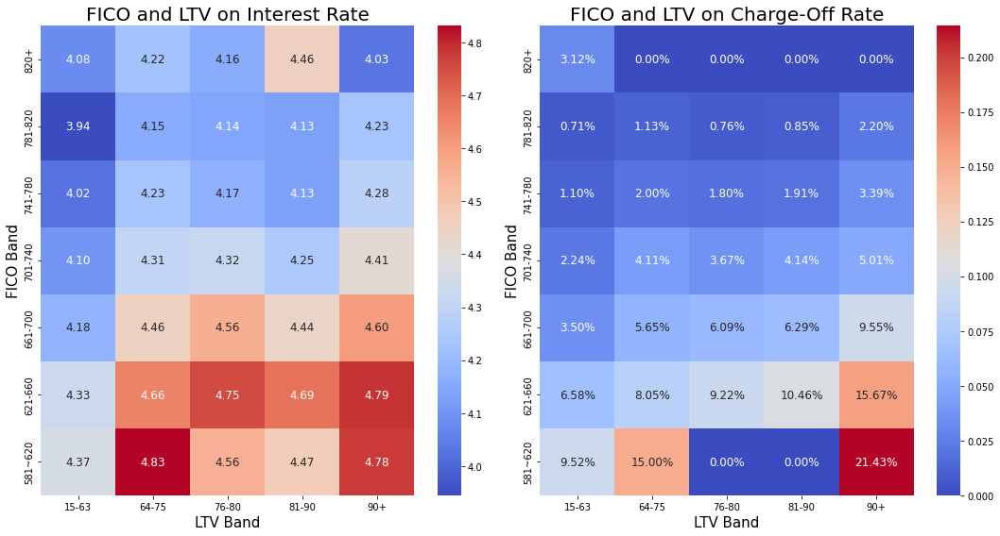

In [165]:

fig, axs = plt.subplots(1, 2, figsize=(15, 8))  # Adjust the figsize as needed

# Chart 1
axs[0].set_title("FICO and LTV on Interest Rate", fontsize=20)
sns.heatmap(fico_ltv_rate, cmap='coolwarm', fmt=".2f", annot=True, annot_kws={"size": 12},  ax=axs[0]).invert_yaxis()
axs[0].set_xlabel('LTV Band', fontsize=15)
axs[0].set_ylabel('FICO Band', fontsize=15)

#chart2
fico_ltv_bad = orig_file_18q1_v2.pivot_table(index='fico_band', columns='ltv_band', values='charge_off', dropna=False)
axs[1].set_title("FICO and LTV on Charge-Off Rate", fontsize=20)
sns.heatmap(fico_ltv_bad, cmap='coolwarm', fmt=".2%", annot=True, annot_kws={"size": 12}, ax=axs[1]).invert_yaxis()
axs[1].set_xlabel('LTV Band', fontsize=15)
axs[1].set_ylabel('FICO Band', fontsize=15)

plt.tight_layout()

plt.show()

#### **Insight** - Heatmap of [Interest Rate & Charge-Off Rate] vs [FICO & LTV Ratio]
As expected the FICO score proved to be a reliable predictor of borrowers' credit risk, leading lenders to charge varying interest rates based on this information. On the other hand, while the Loan-to-Value (LTV) ratio effectively predicted credit risk, lenders did not appear to utilize this information to differentiate interest rates.

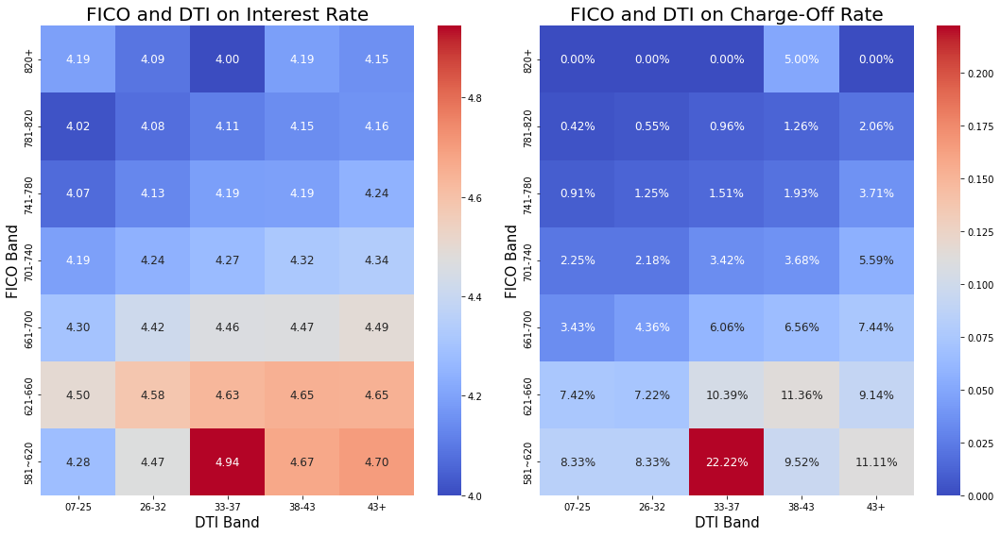

In [170]:
fig, axs = plt.subplots(1, 2, figsize=(15, 8))  # Adjust the figsize as needed

# Chart 1
fico_dti_rate=orig_file_18q1_v2.pivot_table(index='fico_band', columns='dti_band', values='ORIG_RATE', dropna=False)

axs[0].set_title("FICO and DTI on Interest Rate", fontsize=20)
sns.heatmap(fico_dti_rate, cmap='coolwarm', fmt=".2f", annot=True, annot_kws={"size": 12},  ax=axs[0]).invert_yaxis()
axs[0].set_xlabel('DTI Band', fontsize=15)
axs[0].set_ylabel('FICO Band', fontsize=15)

#chart2
fico_dti_bad=orig_file_18q1_v2.pivot_table(index='fico_band', columns='dti_band', values='charge_off', dropna=False)

axs[1].set_title("FICO and DTI on Charge-Off Rate", fontsize=20)
sns.heatmap(fico_dti_bad, cmap='coolwarm', fmt=".2%", annot=True, annot_kws={"size": 12}, ax=axs[1]).invert_yaxis()
axs[1].set_xlabel('DTI Band', fontsize=15)
axs[1].set_ylabel('FICO Band', fontsize=15)

plt.tight_layout()

plt.show()


#### **Insight** - Heatmap of [Interest Rate/Charge-Off Rate] vs [FICO & DTI Ratio]
Mortgage interest rates seem to be consistently priced relative to its risk profile.  Again we observe that DTI similar to LTV does rather poor job of diffentiating risk for those with FICO score below 620.

## Analysis 10 - 3D Visualization of Interest Rate/Charge-Off vs (FICO & LTV & DTI) 

We begin by defining the different tiers for FICO, DTI & LTV

In [262]:
def fico_tier(x):
    if x <= 620: 
        return 600
    elif x <= 660:
        return 640
    elif x <= 700:
        return 680
    elif x <= 740:
        return 720
    elif x <=780:
        return 760
    elif x <=800:
        return 780
    else:
        return 800
    
orig_file_18q1_v2['fico_tier']=orig_file_18q1_v2['min_fico'].apply(fico_tier) 


def ltv_tier(x):
    if x <= 63:
        return 59
    elif x <= 75:
        return 69
    elif x <= 80:
        return 78
    elif x <= 90:
        return 85
    else:
        return 92
    
orig_file_18q1_v2['ltv_tier']=orig_file_18q1_v2['OLTV'].apply(ltv_tier)   


def dti_tier(x):
    if x <= 25: 
        return 20
    elif x <= 32:
        return 29
    elif x <=37:
        return 35
    elif x <= 43:
        return 40
    else:
        return 46
    
orig_file_18q1_v2['dti_tier']=orig_file_18q1_v2['DTI'].apply(dti_tier)


As Matplotlib is not very interactive, we will present 2 opposite views of the 3D rendering.

Let us begin by examining the Charge-off against the risk indicators. 

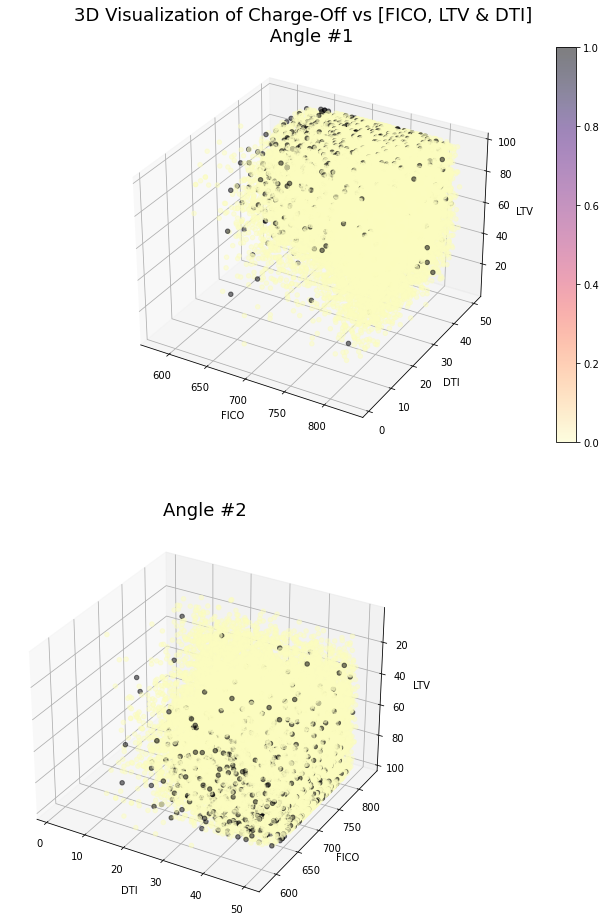

In [336]:
df = orig_file_18q1_v2.sample(frac=1, random_state=42)

plt.rcParams["figure.figsize"] = [18, 16]
plt.rcParams["figure.autolayout"] = True

fig, axs = plt.subplots(2, 1, subplot_kw={'projection': '3d'})  # Adjust the figsize as needed

# Chart 1
img1 = axs[0].scatter(df['min_fico'], df['DTI'], df['OLTV'], 
                 c=df['charge_off'], cmap='magma_r', alpha=0.5)
fig.colorbar(img1, ax=axs[0])
axs[0].set_xlabel('FICO')
axs[0].set_ylabel('DTI')
axs[0].set_zlabel('LTV')
axs[0].set_title('3D Visualization of Charge-Off vs [FICO, LTV & DTI]  \n Angle #1', fontsize=18)

# Chart 2
img2 = axs[1].scatter(df['DTI'], df['min_fico'], df['OLTV'], 
                 c=df['charge_off'], cmap='magma_r', alpha=0.5)
#fig.colorbar(img2, ax=axs[1])

axs[1].invert_zaxis()
axs[1].set_xlabel('DTI')
axs[1].set_ylabel('FICO')
axs[1].set_zlabel('LTV')
axs[1].set_title('Angle #2', fontsize=18)

plt.show()

#### **Insight** - 3D Visualization of Charge-Off Rate vs [FICO, LTV & DTI]
While the FICO score is a reliable indicator of credit risk, its performance is further enhanced when combined with other risk indicators, particularly when adjudicating the low-risk population. In the 2D representation in association with FICO scores, both DTI and LTV appeared to be effective credit risk indicators. However, when all three indicators are used together in the 3D visualization to define the high-risk population, DTI and LTV do not exhibit the same strength as they did in the 2D representation. It is important to note that this analysis is subject to further interpretation since the high-risk population identified by DTI and LTV has been excluded, as their loan applications were rejected.

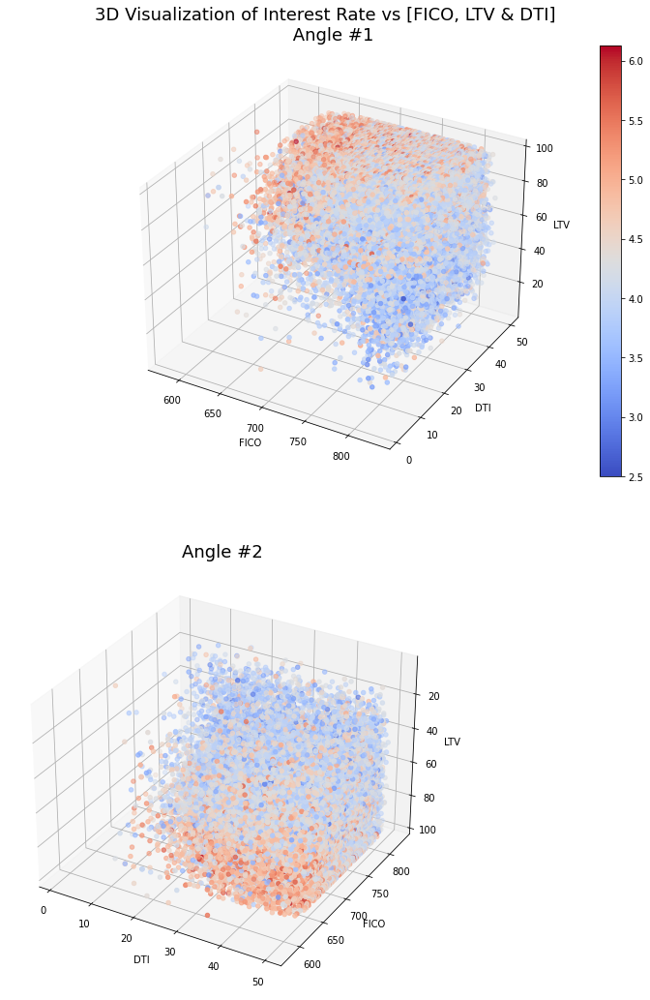

In [339]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

df = orig_file_18q1_v2

plt.rcParams["figure.figsize"] = [20, 18]
plt.rcParams["figure.autolayout"] = True

fig, axs = plt.subplots(2, 1, subplot_kw={'projection': '3d'})  # Adjust the figsize as needed

# Chart 1
img1 = axs[0].scatter(df['min_fico'], df['DTI'], df['OLTV'], 
                 c=df['ORIG_RATE'], cmap='coolwarm')
fig.colorbar(img1, ax=axs[0])
axs[0].set_xlabel('FICO')
axs[0].set_ylabel('DTI')
axs[0].set_zlabel('LTV')
axs[0].set_title('3D Visualization of Interest Rate vs [FICO, LTV & DTI]  \n Angle #1', fontsize=18)

# Chart 2
img2 = axs[1].scatter(df['DTI'], df['min_fico'], df['OLTV'], 
                 c=df['ORIG_RATE'], cmap='coolwarm')
#fig.colorbar(img2, ax=axs[1])

axs[1].invert_zaxis()
axs[1].set_xlabel('DTI')
axs[1].set_ylabel('FICO')
axs[1].set_zlabel('LTV')
axs[1].set_title('Angle #2', fontsize=18)


plt.show()

#### **Insight** - 3D Visualization of Interest Rate vs [FICO, LTV & DTI]
The 3D representation in this analysis is less clear due to the challenging interpretation of the color gradation. Additionally, it's important to note that the high-risk population identified by DTI and LTV has been excluded from the analysis. However, it is worth mentioning that the high-risk population, characterized by low FICO scores, high LTV, and high DTI, did receive higher interest rates, and vice versa. Nevertheless, it remains unclear whether DTI and LTV accurately differentiated the varying degrees of risk, leading to the application of different interest rates.

This chart is too crowded to render any meaningful insight.  Hence we will sample only 10% of the sample for improved visualization.

## Analysis 11 - Logistic Regression to Predict Charge-Off 
We will confirm our visual inspection of the data with statistical analysis.  For the analysis, we use the logistic regression or classification machine learning model to predict a binary outcome ('0' for non-charge off vs. '1' for charge-off). 


<Axes: >

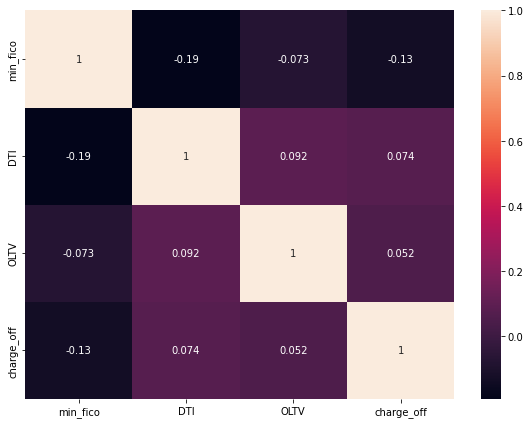

In [310]:
corr=orig_file_18q1_v2[['min_fico', 'DTI', 'OLTV', 'charge_off']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True)

#### **Insight** - Correlation between Charge-Off Rate vs [FICO, LTV & DTI]
As we previously examined visually, the FICO & DTI ratio are more closely associated with the charge-off than the LTV.

In [185]:
!pip install statsmodels --quiet

In [311]:

import statsmodels.formula.api as smf

#fit logistic regression model
model = smf.logit('charge_off ~ min_fico + DTI + OLTV', data=orig_file_18q1_v2).fit()

#view model summary
print(model.summary())

Optimization terminated successfully.
         Current function value: 0.134850
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:             charge_off   No. Observations:                46115
Model:                          Logit   Df Residuals:                    46111
Method:                           MLE   Df Model:                            3
Date:                Mon, 15 May 2023   Pseudo R-squ.:                 0.07628
Time:                        20:20:44   Log-Likelihood:                -6218.6
converged:                       True   LL-Null:                       -6732.2
Covariance Type:            nonrobust   LLR p-value:                2.397e-222
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      3.6977      0.439      8.419      0.000       2.837       4.558
min_fico      -0.0137      0.

#### **Insight** - Logistic Regression Analysis
Let us examine each key variable and interprete the result.  'coef' (variable coefficient) & P>|z| (typically P-value < 0.05 usually implies strong reliability of that variable)
* FICO: coef=-0.0137 w/ P-value=0 >> A negative coefficient indicates an inverse relationship between charge-off and FICO. In other words, a higher FICO score suggests lower risk.
* DTI: coef=0.0377 w/ P-value=0 >> A positive coefficient indicates a positive association between charge-off and DTI. In other words, a higher DTI suggests higher risk.
* OLTV: coef=0.00183 w/ P-value=0 >> Again OLTV/LTV is positively associated with the charge-off. A high LTV suggests higher risk.

But the simple logistic regression model built based on FICO, DTI & LTV only is a weak model with Pseudo R-square of 0.07628, i.e. the model can only explain 7.6% of the variation in the model.

## Analysis 12 - Linear Regression to Predict Interest Rate
Linear regression will be used to predict the mortgage interest rate.  The model using only three variable should not be very powerful.

<Axes: >

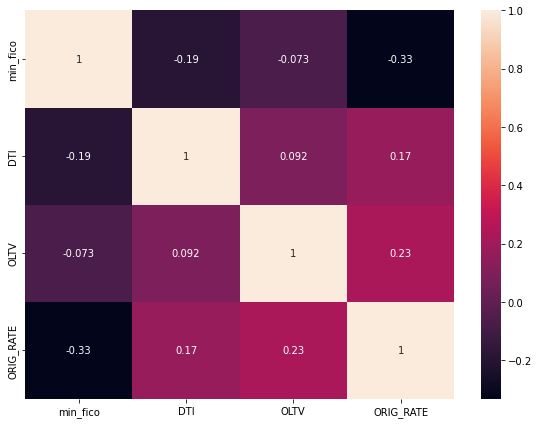

In [313]:
corr=orig_file_18q1_v2[['min_fico', 'DTI', 'OLTV', 'ORIG_RATE']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True)

In [315]:
import statsmodels.formula.api as smf

#fit logistic regression model
model = smf.ols('ORIG_RATE ~ min_fico + DTI + OLTV', data=orig_file_18q1_v2).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:              ORIG_RATE   R-squared:                       0.162
Model:                            OLS   Adj. R-squared:                  0.162
Method:                 Least Squares   F-statistic:                     2970.
Date:                Mon, 15 May 2023   Prob (F-statistic):               0.00
Time:                        20:23:59   Log-Likelihood:                -25887.
No. Observations:               46115   AIC:                         5.178e+04
Df Residuals:                   46111   BIC:                         5.182e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      5.8452      0.035    167.273      0.0

#### **Insight** - Linear Regression Analysis
Once again, all three variables demonstrated their reliability as indicators, as evidenced by their low p-values close to zero. However, it is important to note that the R-squared value, which indicates the proportion of variance explained by the three dependent variables, remains weak, with an explanatory power of only 16.2%.

# IV. Summary
* An analysis of FICO score, LTV, and DTI highlights the notable enhancement in borrower risk profiles between 2018 and 2022 compared to 2008. This improvement can be attributed to stricter credit standards, such as excluding subprime borrowers (FICO score below 620), imposing tighter restrictions on DTI and LTV ratios, and discontinuing Interest-Only loans. The credit risk profile appears to have further strengthened in 2022, with a larger proportion of borrowers falling within the prime FICO score range.
* A detailed analysis of the 2018 mortgage loans reveals a pricing alignment with the associated risk levels. This implies that individuals with lower FICO scores and higher loan-to-value (LTV) ratios are perceived as high-risk borrowers, leading to higher interest rates. However, an intriguing finding emerges: borrowers with excellent FICO scores of 820 or above consistently face inflated prices, resulting in elevated interest rates. This presents an opportunity for lenders to potentially offer lower rates to attract the super-prime borrowers.
* Lenders tend to prioritize FICO and LTV risk indicators when determining loan interest rates, while placing less emphasis on DTI. DTI values across a range do not strongly differentiate interest rates. However, combining FICO score and DTI yields promising results for predicting the charge-off rate. By envisioning an imaginary 2D plane spanning from high FICO/DTI to low FICO/DTI, high-risk borrowers can be effectively distinguished from low-risk borrowers. LTV becomes effective in assessing risk profiles when it surpasses a specific threshold of approximately 60%, leading to a clear differentiation in risk profiles.

### Credit:
I would like to express my gratitude to Jovian for providing the necessary training to conduct this data analysis. Additionally, I extend my heartfelt thanks to Alec Lin, a seasoned Data Scientist with over 20 years of experience, for guiding me throughout this project. Thank you, Alec!